<a href="https://colab.research.google.com/github/Vinod1403/Surprise-Housing-Case-Study/blob/main/Surprise_housing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install pytest-warnings
#!pip freeze
#!pip install numpy
#!pip install pandas
#!pip install matplotlib
#!pip install seaborn
#!pip install scikit-learn

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import numpy as np
import pandas as pd
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

## Import and Inspect The Dataset

In [ ]:
housing=pd.read_csv("train.csv")
housing.head

<bound method NDFrame.head of         Id  MSSubClass MSZoning  LotFrontage  LotArea Street Alley LotShape  \
0        1          60       RL         65.0     8450   Pave   NaN      Reg   
1        2          20       RL         80.0     9600   Pave   NaN      Reg   
2        3          60       RL         68.0    11250   Pave   NaN      IR1   
3        4          70       RL         60.0     9550   Pave   NaN      IR1   
4        5          60       RL         84.0    14260   Pave   NaN      IR1   
5        6          50       RL         85.0    14115   Pave   NaN      IR1   
6        7          20       RL         75.0    10084   Pave   NaN      Reg   
7        8          60       RL          NaN    10382   Pave   NaN      IR1   
8        9          50       RM         51.0     6120   Pave   NaN      Reg   
9       10         190       RL         50.0     7420   Pave   NaN      Reg   
10      11          20       RL         70.0    11200   Pave   NaN      Reg   
11      12          60

In [ ]:
housing.shape

(1460, 81)

In [ ]:
housing.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [ ]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [ ]:
housing.isnull().sum()/housing.shape[0]*100

Id                0.000000
MSSubClass        0.000000
MSZoning          0.000000
LotFrontage      17.739726
LotArea           0.000000
Street            0.000000
Alley            93.767123
LotShape          0.000000
LandContour       0.000000
Utilities         0.000000
LotConfig         0.000000
LandSlope         0.000000
Neighborhood      0.000000
Condition1        0.000000
Condition2        0.000000
BldgType          0.000000
HouseStyle        0.000000
OverallQual       0.000000
OverallCond       0.000000
YearBuilt         0.000000
YearRemodAdd      0.000000
RoofStyle         0.000000
RoofMatl          0.000000
Exterior1st       0.000000
Exterior2nd       0.000000
MasVnrType       59.726027
MasVnrArea        0.547945
ExterQual         0.000000
ExterCond         0.000000
Foundation        0.000000
BsmtQual          2.534247
BsmtCond          2.534247
BsmtExposure      2.602740
BsmtFinType1      2.534247
BsmtFinSF1        0.000000
BsmtFinType2      2.602740
BsmtFinSF2        0.000000
B

## DATA CLEANING

In [ ]:
cols = ['Alley', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
        'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond',
        'PoolQC', 'Fence', 'MiscFeature']
for i in cols:
    housing[i].fillna("None",inplace=True)

In [ ]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          1460 non-null   object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [ ]:
#Import Visualization Libs
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

<Figure size 600x600 with 0 Axes>

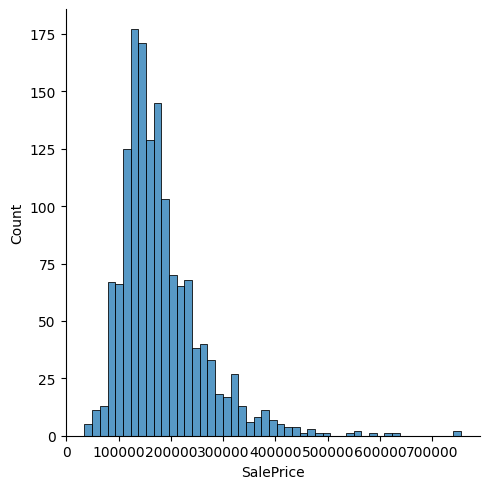

In [ ]:
#Checking if the target variable SalePrice is normally distributed or right skwed or left skewed
plt.figure(figsize=[6,6])
sns.displot(housing['SalePrice'])
plt.show()

## We can see that the target variable SalePrice is right skewed

In [ ]:
print("Skewness",housing["SalePrice"].skew())
print("Kurtosis",housing["SalePrice"].kurt())

Skewness 1.8828757597682129
Kurtosis 6.536281860064529


In [ ]:
##We can observe that target variable has skewness greater than one and has high density around the saleprice of 16000
#Hence we can do data transformation for this variable

In [ ]:
#Log Transformation
housing['SalePrice']=np.log(housing["SalePrice"])

<Figure size 600x600 with 0 Axes>

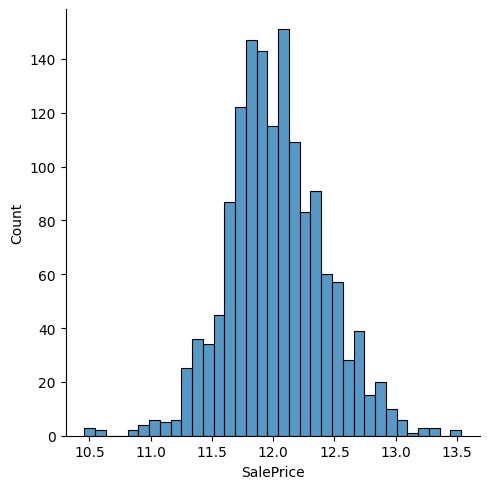

In [ ]:
plt.figure(figsize=[6,6])
sns.displot(housing['SalePrice'])
plt.show()

In [ ]:
print("Skewness",housing["SalePrice"].skew())
print("Kurtosis",housing["SalePrice"].kurt())

Skewness 0.12133506220520406
Kurtosis 0.8095319958036296


## Convert MSsubclass,Overall Quality,OverallCond to object datatype
##Convert 'Logfrontage','MasvnrArea' as Numeric Data Type

In [ ]:
housing.drop("Id",axis=1,inplace=True)

In [ ]:
housing[['MSSubClass','OverallQual','OverallCond']]=housing[['MSSubClass','OverallQual','OverallCond']].astype('object')

In [ ]:
housing['LotFrontage'] = pd.to_numeric(housing['LotFrontage'], errors='coerce')
housing['MasVnrArea'] = pd.to_numeric(housing['MasVnrArea'], errors='coerce')

In [ ]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1460 non-null   object 
 1   MSZoning       1460 non-null   object 
 2   LotFrontage    1201 non-null   float64
 3   LotArea        1460 non-null   int64  
 4   Street         1460 non-null   object 
 5   Alley          1460 non-null   object 
 6   LotShape       1460 non-null   object 
 7   LandContour    1460 non-null   object 
 8   Utilities      1460 non-null   object 
 9   LotConfig      1460 non-null   object 
 10  LandSlope      1460 non-null   object 
 11  Neighborhood   1460 non-null   object 
 12  Condition1     1460 non-null   object 
 13  Condition2     1460 non-null   object 
 14  BldgType       1460 non-null   object 
 15  HouseStyle     1460 non-null   object 
 16  OverallQual    1460 non-null   object 
 17  OverallCond    1460 non-null   object 
 18  YearBuil

In [ ]:
null_cols=housing.columns[housing.isnull().any()]
null_cols

Index(['LotFrontage', 'MasVnrType', 'MasVnrArea', 'Electrical', 'GarageYrBlt'], dtype='object')

In [ ]:
for i in null_cols:
    if housing[i].dtype == np.float64 or housing[i].dtype == np.int64:
        housing[i].fillna(housing[i].mean(), inplace=True)
    else:
        housing[i].fillna(housing[i].mode()[0], inplace=True)


In [ ]:
housing.isna().sum()

MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual 

## STEP 3: EDA on the dataset

In [ ]:
#List of categorical columns
cat_cols=housing.select_dtypes(include='object').columns
cat_cols

Index(['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour',
       'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1',
       'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu',
       'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive',
       'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition'],
      dtype='object')

In [ ]:
#List of numerical columns
num_cols=housing.select_dtypes(include=['int64','float64']).columns
num_cols

Index(['LotFrontage', 'LotArea', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea',
       'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF',
       '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath',
       'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

## Univarient Analaysis

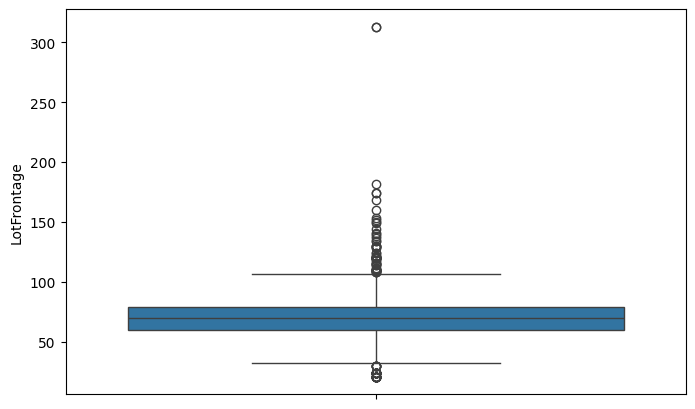

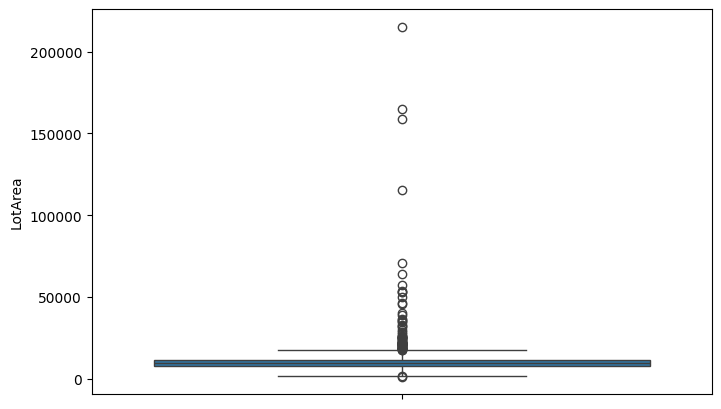

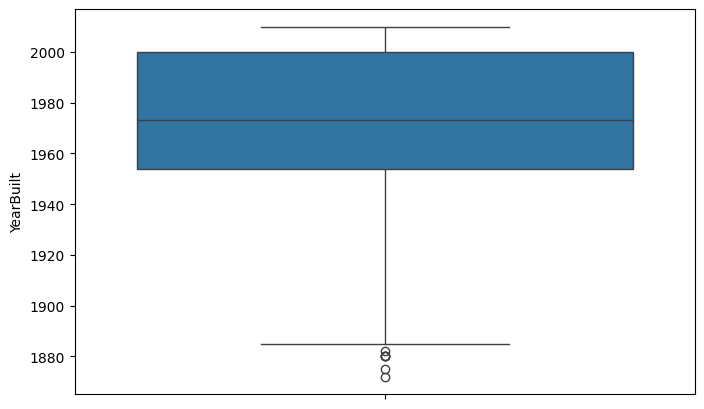

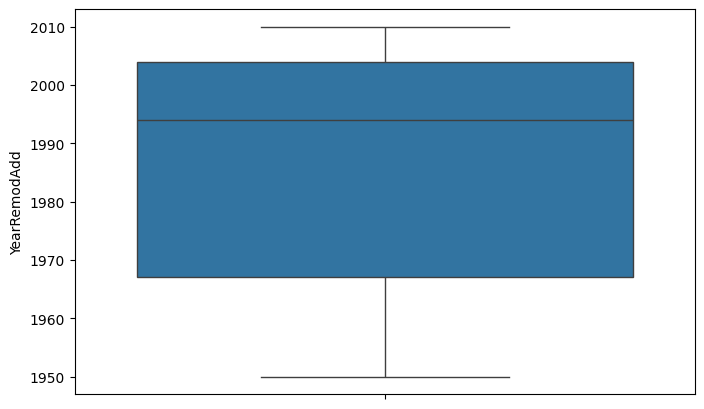

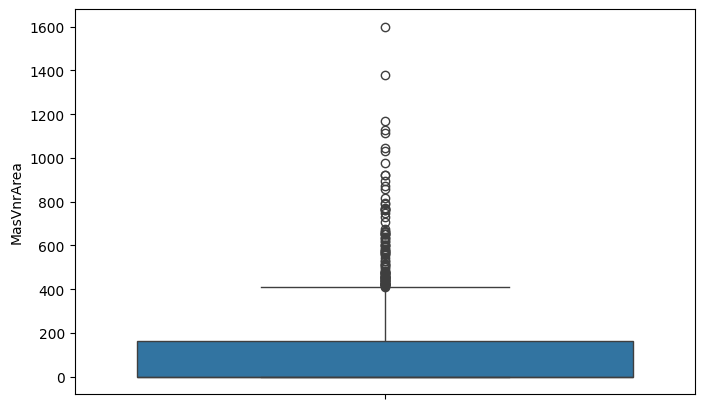

...

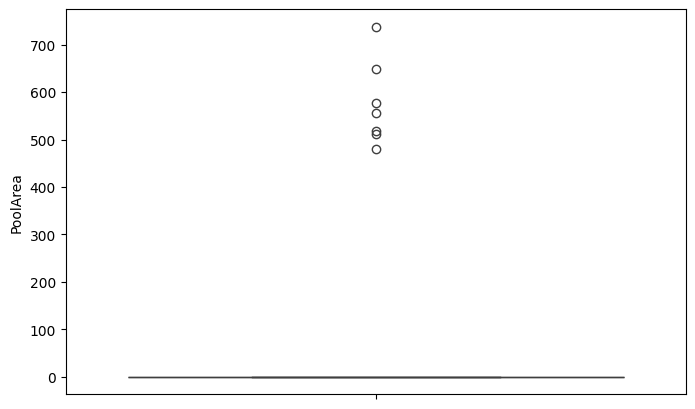

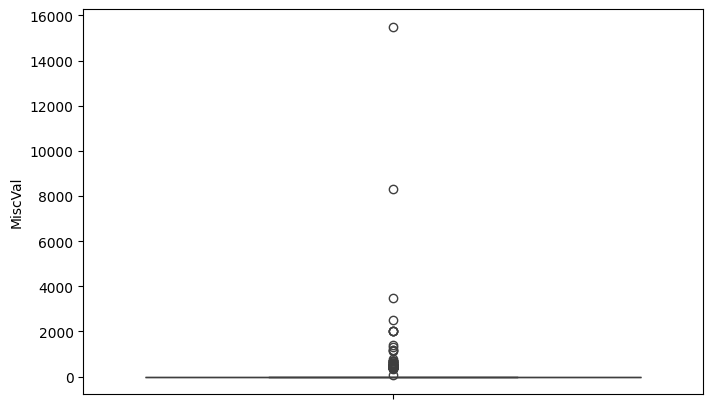

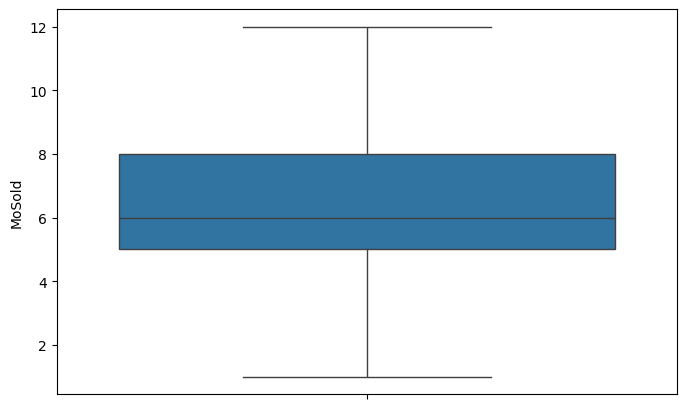

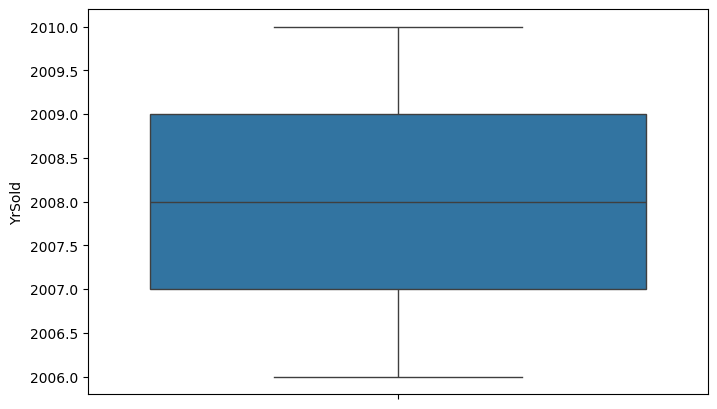

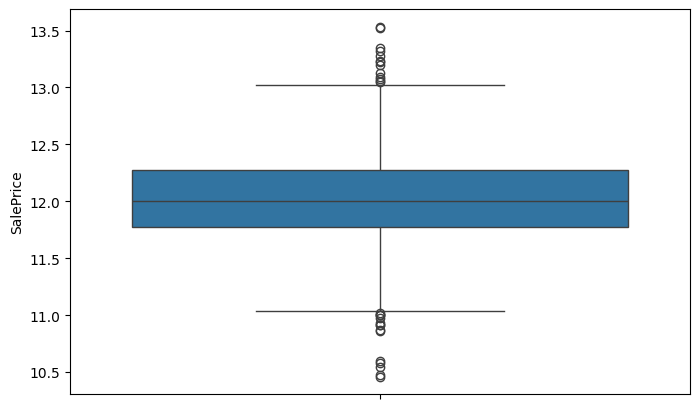

In [ ]:
#Numerical Columns
#PLotting Box Plot to visualize the distribution and check for the outliers
for i in num_cols:
    plt.figure(figsize=[8,5])
    sns.boxplot(housing[i])
    plt.show()

## We can see the outliers in LotFrontage,LotArea,YearBuilt,MaxVnrArea,BsmtFinSF1,BsmtFinSF1,BsmtFinSF

MSSubClass
20     0.367123
60     0.204795
50     0.098630
120    0.059589
30     0.047260
160    0.043151
70     0.041096
80     0.039726
90     0.035616
190    0.020548
85     0.013699
75     0.010959
45     0.008219
180    0.006849
40     0.002740
Name: proportion, dtype: float64


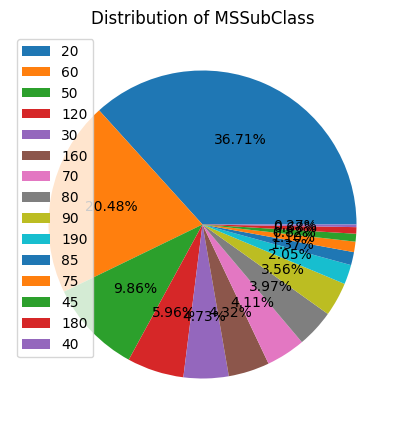

.................................................................
MSZoning
RL         0.788356
RM         0.149315
FV         0.044521
RH         0.010959
C (all)    0.006849
Name: proportion, dtype: float64


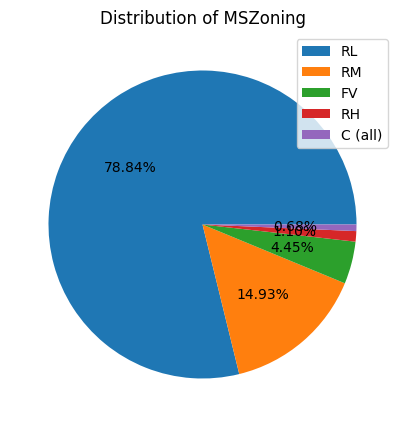

.................................................................
Street
Pave    0.99589
Grvl    0.00411
Name: proportion, dtype: float64


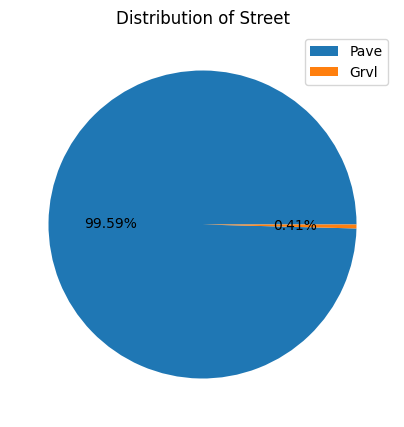

.................................................................
Alley
None    0.937671
Grvl    0.034247
Pave    0.028082
Name: proportion, dtype: float64


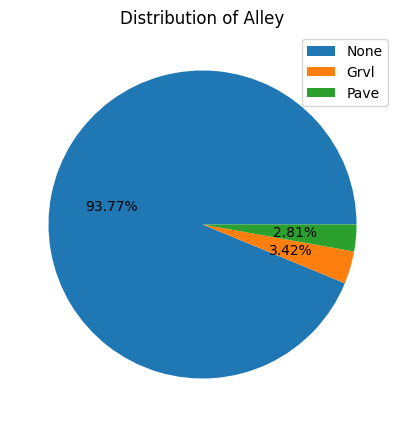

.................................................................
LotShape
Reg    0.633562
IR1    0.331507
IR2    0.028082
IR3    0.006849
Name: proportion, dtype: float64


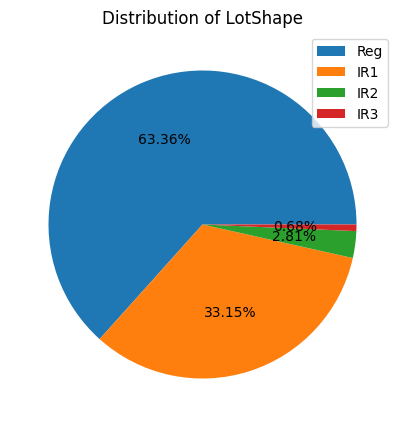

.................................................................
LandContour
Lvl    0.897945
Bnk    0.043151
HLS    0.034247
Low    0.024658
Name: proportion, dtype: float64


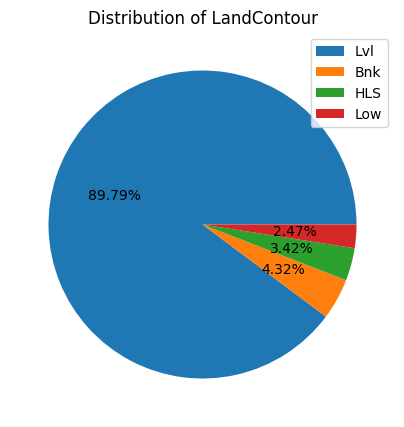

.................................................................
Utilities
AllPub    0.999315
NoSeWa    0.000685
Name: proportion, dtype: float64


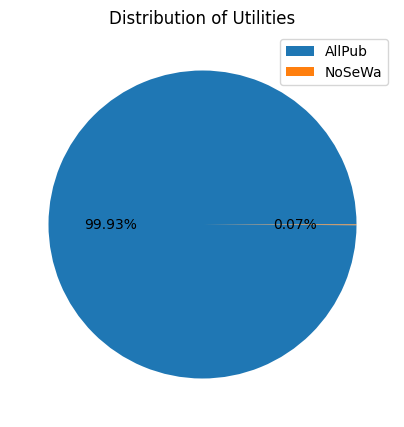

.................................................................
LotConfig
Inside     0.720548
Corner     0.180137
CulDSac    0.064384
FR2        0.032192
FR3        0.002740
Name: proportion, dtype: float64


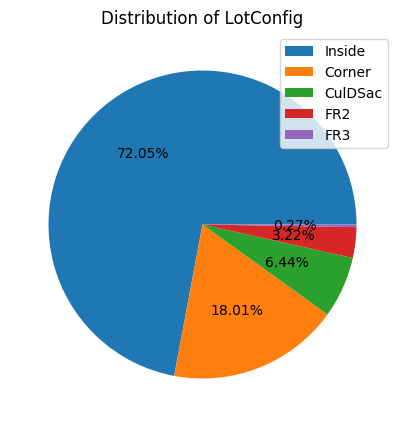

.................................................................
LandSlope
Gtl    0.946575
Mod    0.044521
Sev    0.008904
Name: proportion, dtype: float64


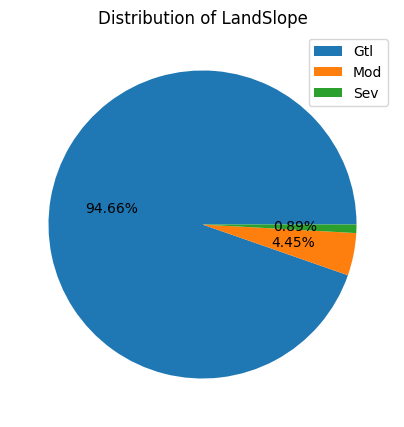

.................................................................
Neighborhood
NAmes      0.154110
CollgCr    0.102740
OldTown    0.077397
Edwards    0.068493
Somerst    0.058904
Gilbert    0.054110
NridgHt    0.052740
Sawyer     0.050685
NWAmes     0.050000
SawyerW    0.040411
BrkSide    0.039726
Crawfor    0.034932
Mitchel    0.033562
NoRidge    0.028082
Timber     0.026027
IDOTRR     0.025342
ClearCr    0.019178
SWISU      0.017123
StoneBr    0.017123
Blmngtn    0.011644
MeadowV    0.011644
BrDale     0.010959
Veenker    0.007534
NPkVill    0.006164
Blueste    0.001370
Name: proportion, dtype: float64


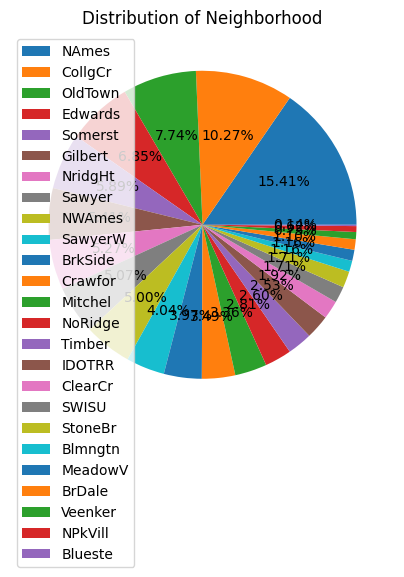

.................................................................
Condition1
Norm      0.863014
Feedr     0.055479
Artery    0.032877
RRAn      0.017808
PosN      0.013014
RRAe      0.007534
PosA      0.005479
RRNn      0.003425
RRNe      0.001370
Name: proportion, dtype: float64


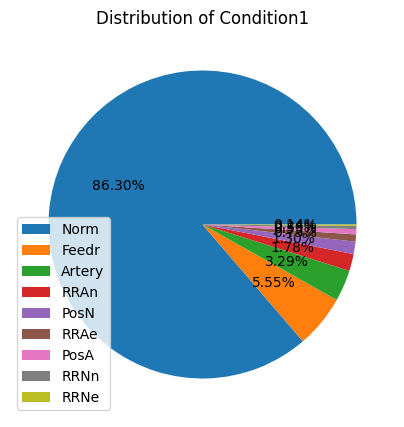

.................................................................
Condition2
Norm      0.989726
Feedr     0.004110
Artery    0.001370
RRNn      0.001370
PosN      0.001370
PosA      0.000685
RRAn      0.000685
RRAe      0.000685
Name: proportion, dtype: float64


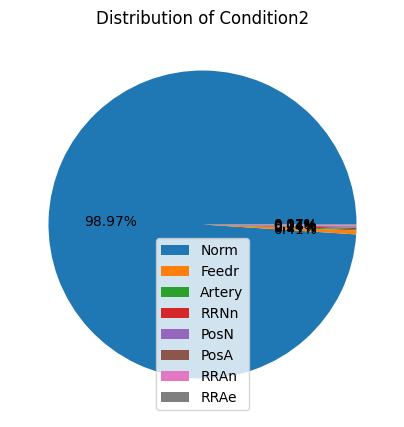

.................................................................
BldgType
1Fam      0.835616
TwnhsE    0.078082
Duplex    0.035616
Twnhs     0.029452
2fmCon    0.021233
Name: proportion, dtype: float64


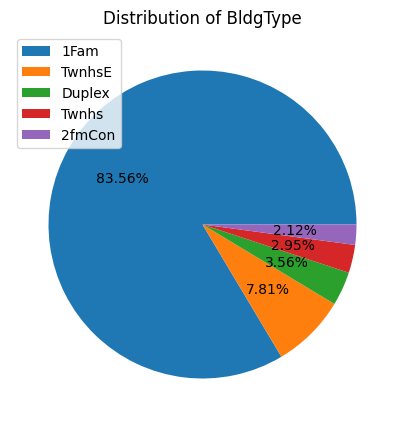

.................................................................
HouseStyle
1Story    0.497260
2Story    0.304795
1.5Fin    0.105479
SLvl      0.044521
SFoyer    0.025342
1.5Unf    0.009589
2.5Unf    0.007534
2.5Fin    0.005479
Name: proportion, dtype: float64


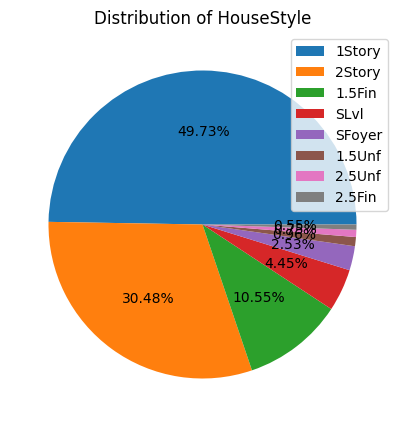

.................................................................
OverallQual
5     0.271918
6     0.256164
7     0.218493
8     0.115068
4     0.079452
9     0.029452
3     0.013699
10    0.012329
2     0.002055
1     0.001370
Name: proportion, dtype: float64


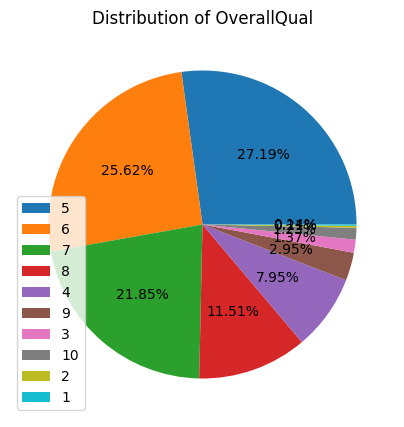

.................................................................
OverallCond
5    0.562329
6    0.172603
7    0.140411
8    0.049315
4    0.039041
3    0.017123
9    0.015068
2    0.003425
1    0.000685
Name: proportion, dtype: float64


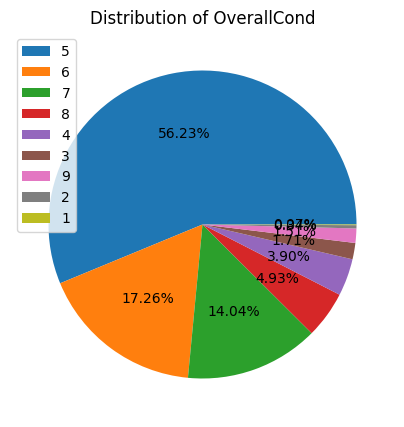

.................................................................
RoofStyle
Gable      0.781507
Hip        0.195890
Flat       0.008904
Gambrel    0.007534
Mansard    0.004795
Shed       0.001370
Name: proportion, dtype: float64


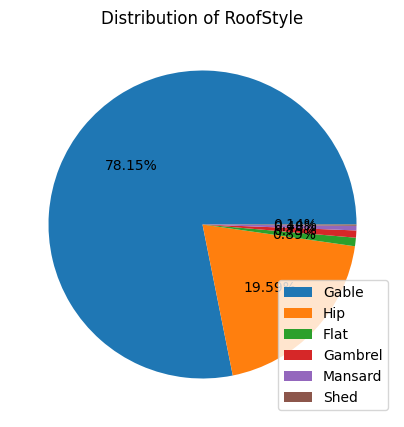

.................................................................
RoofMatl
CompShg    0.982192
Tar&Grv    0.007534
WdShngl    0.004110
WdShake    0.003425
Metal      0.000685
Membran    0.000685
Roll       0.000685
ClyTile    0.000685
Name: proportion, dtype: float64


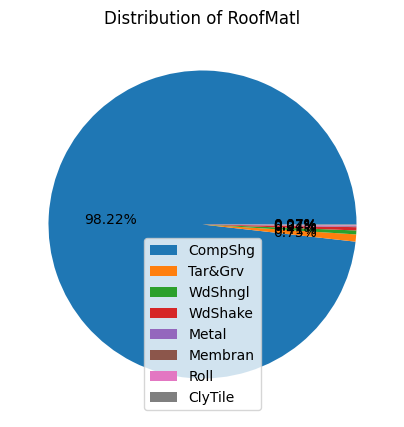

.................................................................
Exterior1st
VinylSd    0.352740
HdBoard    0.152055
MetalSd    0.150685
Wd Sdng    0.141096
Plywood    0.073973
CemntBd    0.041781
BrkFace    0.034247
WdShing    0.017808
Stucco     0.017123
AsbShng    0.013699
BrkComm    0.001370
Stone      0.001370
AsphShn    0.000685
ImStucc    0.000685
CBlock     0.000685
Name: proportion, dtype: float64


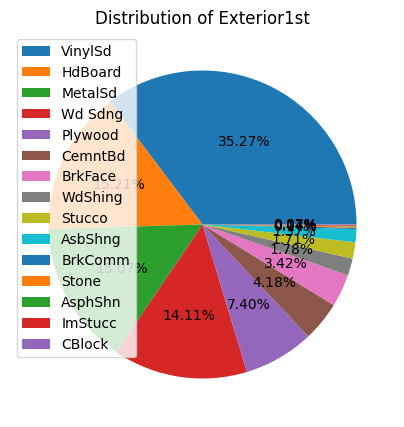

.................................................................
Exterior2nd
VinylSd    0.345205
MetalSd    0.146575
HdBoard    0.141781
Wd Sdng    0.134932
Plywood    0.097260
CmentBd    0.041096
Wd Shng    0.026027
Stucco     0.017808
BrkFace    0.017123
AsbShng    0.013699
ImStucc    0.006849
Brk Cmn    0.004795
Stone      0.003425
AsphShn    0.002055
Other      0.000685
CBlock     0.000685
Name: proportion, dtype: float64


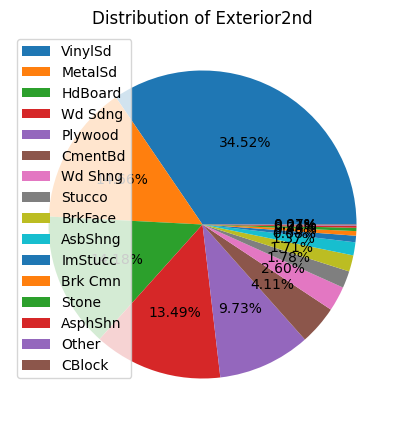

.................................................................
MasVnrType
BrkFace    0.902055
Stone      0.087671
BrkCmn     0.010274
Name: proportion, dtype: float64


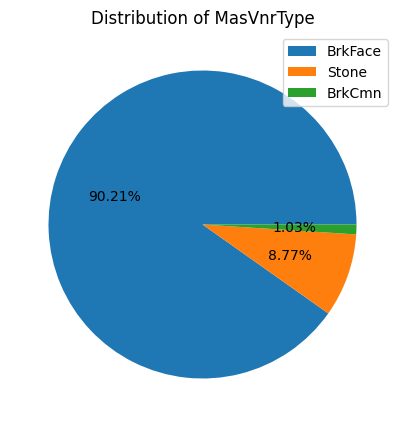

.................................................................
ExterQual
TA    0.620548
Gd    0.334247
Ex    0.035616
Fa    0.009589
Name: proportion, dtype: float64


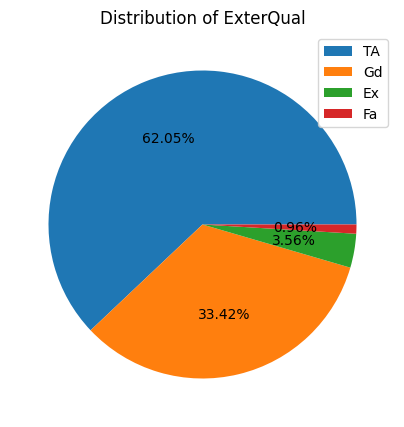

.................................................................
ExterCond
TA    0.878082
Gd    0.100000
Fa    0.019178
Ex    0.002055
Po    0.000685
Name: proportion, dtype: float64


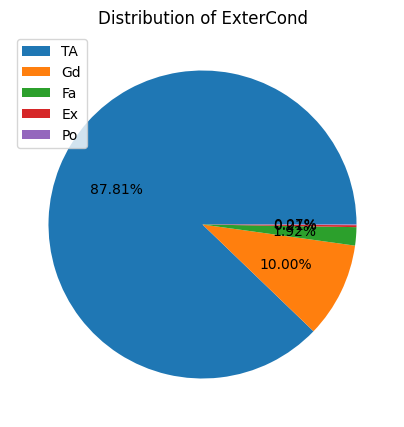

.................................................................
Foundation
PConc     0.443151
CBlock    0.434247
BrkTil    0.100000
Slab      0.016438
Stone     0.004110
Wood      0.002055
Name: proportion, dtype: float64


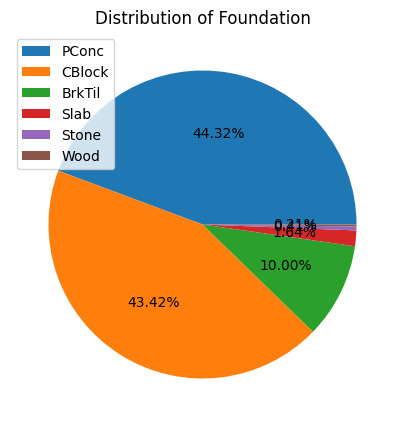

.................................................................
BsmtQual
TA      0.444521
Gd      0.423288
Ex      0.082877
None    0.025342
Fa      0.023973
Name: proportion, dtype: float64


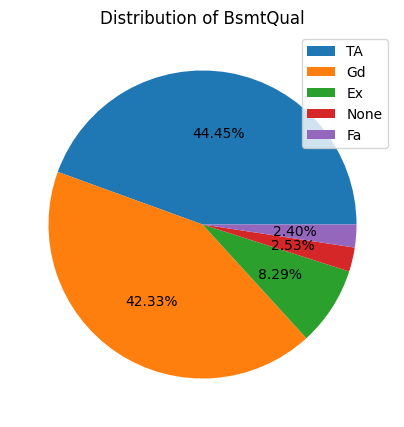

.................................................................
BsmtCond
TA      0.897945
Gd      0.044521
Fa      0.030822
None    0.025342
Po      0.001370
Name: proportion, dtype: float64


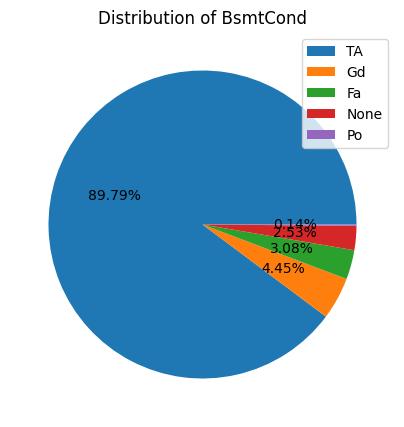

.................................................................
BsmtExposure
No      0.652740
Av      0.151370
Gd      0.091781
Mn      0.078082
None    0.026027
Name: proportion, dtype: float64


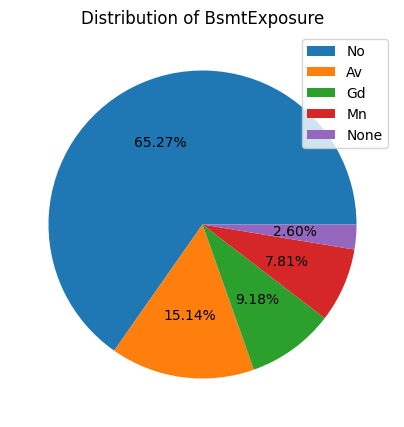

.................................................................
BsmtFinType1
Unf     0.294521
GLQ     0.286301
ALQ     0.150685
BLQ     0.101370
Rec     0.091096
LwQ     0.050685
None    0.025342
Name: proportion, dtype: float64


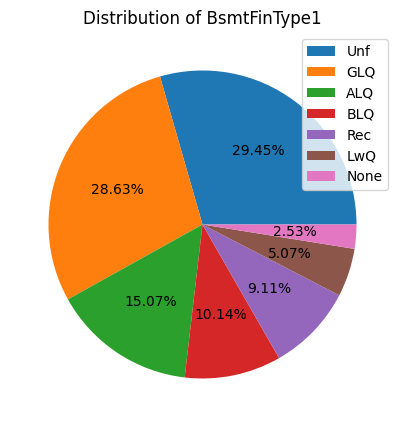

.................................................................
BsmtFinType2
Unf     0.860274
Rec     0.036986
LwQ     0.031507
None    0.026027
BLQ     0.022603
ALQ     0.013014
GLQ     0.009589
Name: proportion, dtype: float64


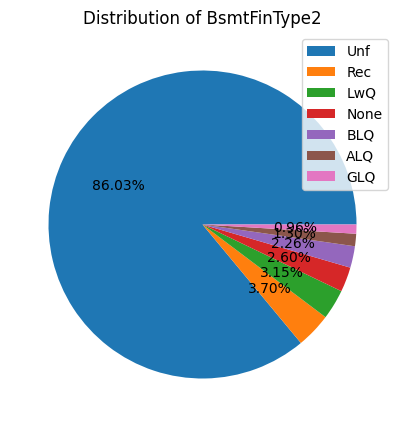

.................................................................
Heating
GasA     0.978082
GasW     0.012329
Grav     0.004795
Wall     0.002740
OthW     0.001370
Floor    0.000685
Name: proportion, dtype: float64


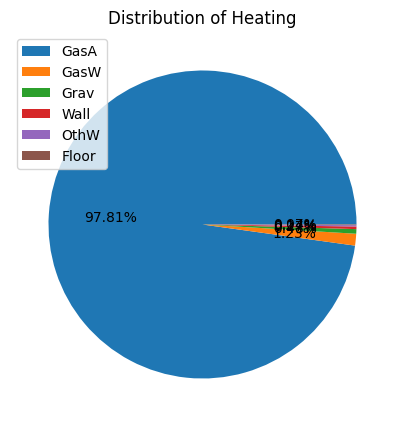

.................................................................
HeatingQC
Ex    0.507534
TA    0.293151
Gd    0.165068
Fa    0.033562
Po    0.000685
Name: proportion, dtype: float64


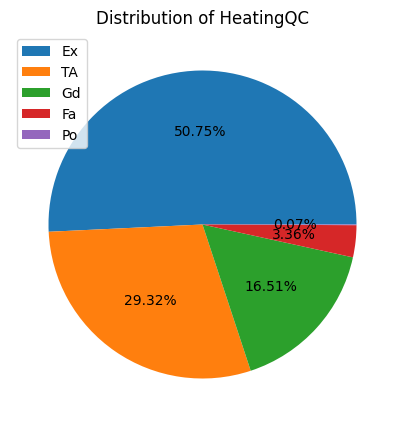

.................................................................
CentralAir
Y    0.934932
N    0.065068
Name: proportion, dtype: float64


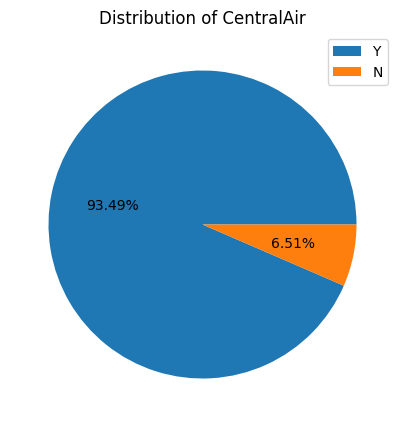

.................................................................
Electrical
SBrkr    0.914384
FuseA    0.064384
FuseF    0.018493
FuseP    0.002055
Mix      0.000685
Name: proportion, dtype: float64


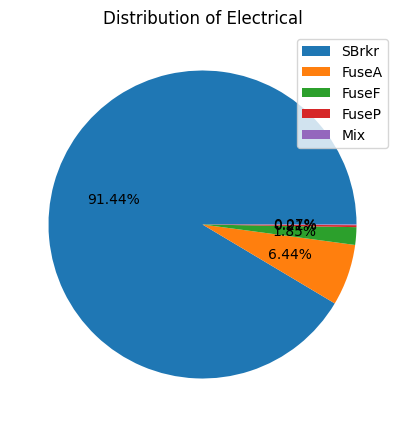

.................................................................
KitchenQual
TA    0.503425
Gd    0.401370
Ex    0.068493
Fa    0.026712
Name: proportion, dtype: float64


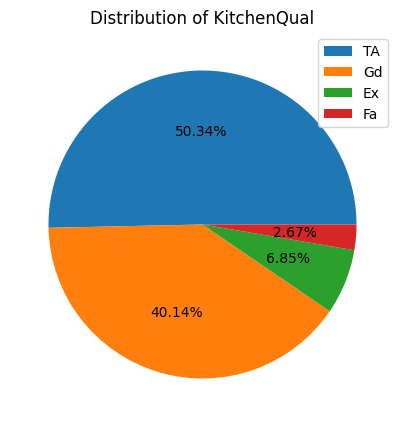

.................................................................
Functional
Typ     0.931507
Min2    0.023288
Min1    0.021233
Mod     0.010274
Maj1    0.009589
Maj2    0.003425
Sev     0.000685
Name: proportion, dtype: float64


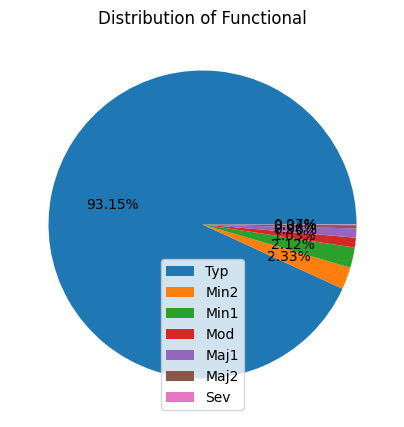

.................................................................
FireplaceQu
None    0.472603
Gd      0.260274
TA      0.214384
Fa      0.022603
Ex      0.016438
Po      0.013699
Name: proportion, dtype: float64


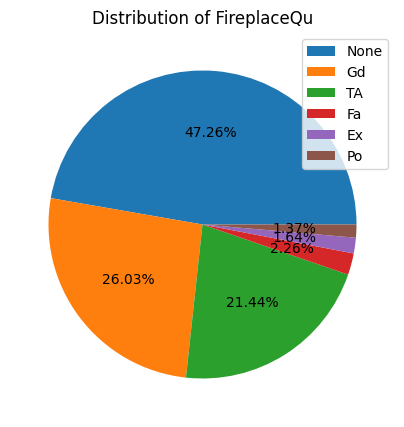

.................................................................
GarageType
Attchd     0.595890
Detchd     0.265068
BuiltIn    0.060274
None       0.055479
Basment    0.013014
CarPort    0.006164
2Types     0.004110
Name: proportion, dtype: float64


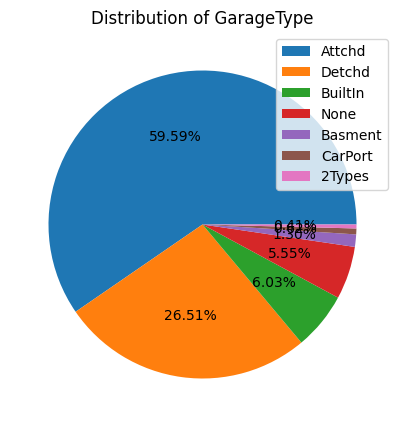

.................................................................
GarageFinish
Unf     0.414384
RFn     0.289041
Fin     0.241096
None    0.055479
Name: proportion, dtype: float64


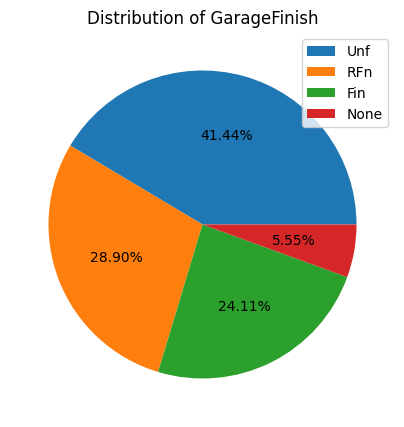

.................................................................
GarageQual
TA      0.897945
None    0.055479
Fa      0.032877
Gd      0.009589
Ex      0.002055
Po      0.002055
Name: proportion, dtype: float64


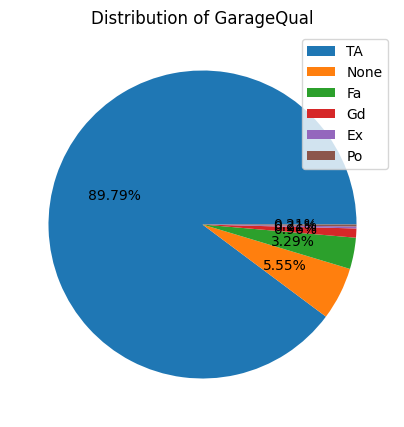

.................................................................
GarageCond
TA      0.908219
None    0.055479
Fa      0.023973
Gd      0.006164
Po      0.004795
Ex      0.001370
Name: proportion, dtype: float64


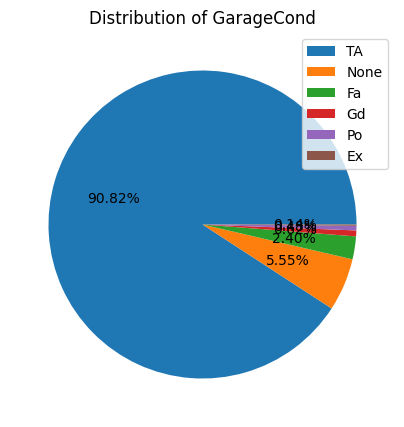

.................................................................
PavedDrive
Y    0.917808
N    0.061644
P    0.020548
Name: proportion, dtype: float64


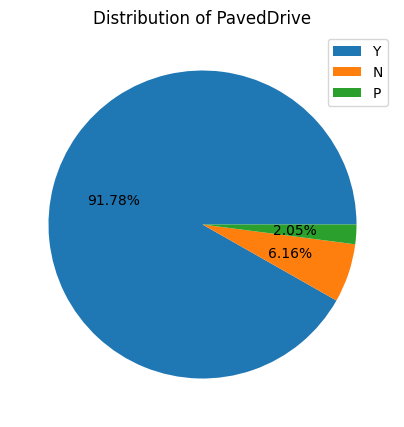

.................................................................
PoolQC
None    0.995205
Gd      0.002055
Ex      0.001370
Fa      0.001370
Name: proportion, dtype: float64


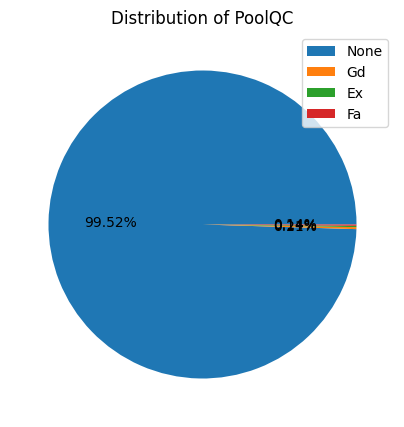

.................................................................
Fence
None     0.807534
MnPrv    0.107534
GdPrv    0.040411
GdWo     0.036986
MnWw     0.007534
Name: proportion, dtype: float64


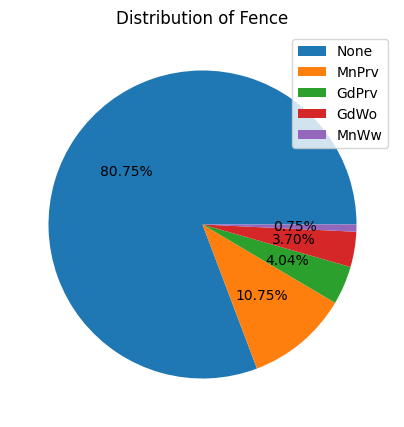

.................................................................
MiscFeature
None    0.963014
Shed    0.033562
Gar2    0.001370
Othr    0.001370
TenC    0.000685
Name: proportion, dtype: float64


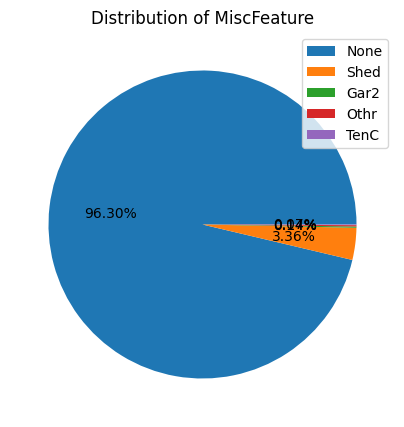

.................................................................
SaleType
WD       0.867808
New      0.083562
COD      0.029452
ConLD    0.006164
ConLI    0.003425
ConLw    0.003425
CWD      0.002740
Oth      0.002055
Con      0.001370
Name: proportion, dtype: float64


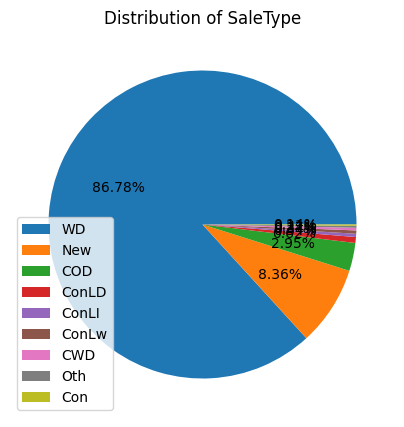

.................................................................
SaleCondition
Normal     0.820548
Partial    0.085616
Abnorml    0.069178
Family     0.013699
Alloca     0.008219
AdjLand    0.002740
Name: proportion, dtype: float64


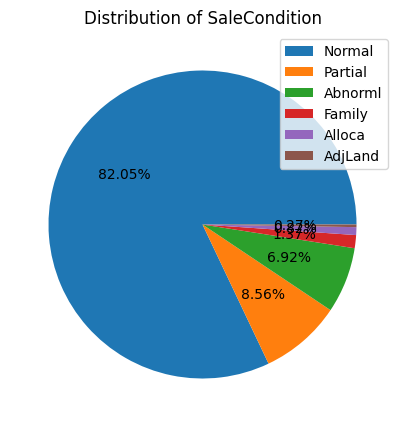

.................................................................


In [ ]:
#Categorical columns
#Pie plot to visualize the value distribution in each category
for i in cat_cols:
    print(housing[i].value_counts(normalize=True))
    plt.figure(figsize=[5,5])
    housing[i].value_counts(normalize=True).plot.pie(labeldistance=None, autopct='%1.2f%%')
    plt.legend()
    plt.title(f'Distribution of {i}')
    plt.ylabel('')  # Optional: removes y-axis label for cleaner pie chart
    plt.show()
    print(".................................................................")

## We can look percentage of values in category of columns and infer that , 'MSZoning','Street','LandContour','Utilities','LotConfig','LandSlope','Condition1','Condition2',BigType  etc.., columns are having more than 70% of the istribution in single category

## Bivariant/Multi variant Analysis on the Dataset

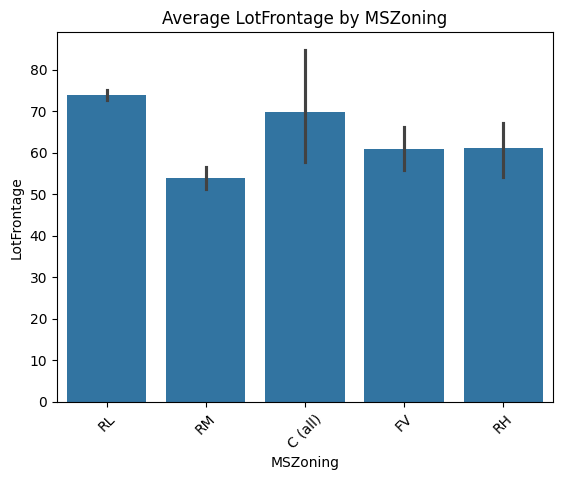

In [ ]:
#Plot of MSZoning vs LotFrontage
sns.barplot(x='MSZoning', y='LotFrontage', data=housing)
plt.title('Average LotFrontage by MSZoning')
plt.ylabel('LotFrontage')
plt.xlabel('MSZoning')
plt.xticks(rotation=45)  # Optional: rotates x-axis labels for readability
plt.show()

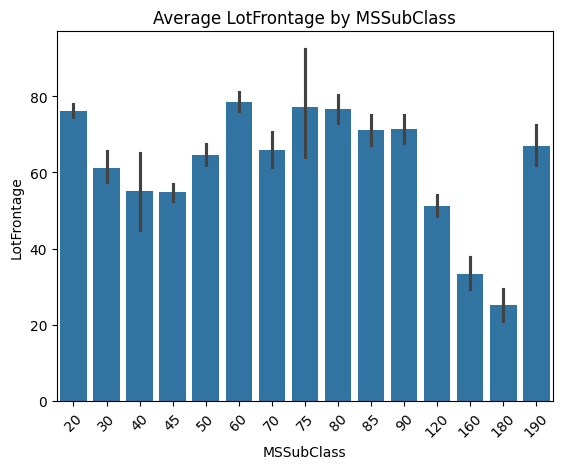

In [ ]:
sns.barplot(x='MSSubClass', y='LotFrontage', data=housing)
plt.title('Average LotFrontage by MSSubClass')
plt.ylabel('LotFrontage')
plt.xlabel('MSSubClass')
plt.xticks(rotation=45)  # Optional: rotates x-axis labels for readability
plt.show()

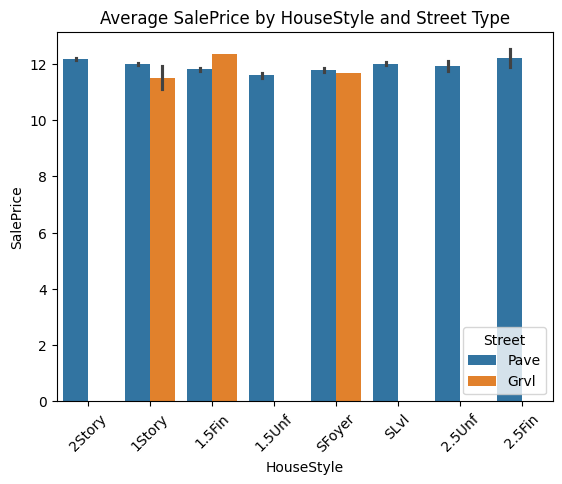

In [ ]:
#Plot of HouseStyle vs SalsePrice Based upon on the street
sns.barplot(x="HouseStyle", y="SalePrice", hue="Street", data=housing)
plt.title("Average SalePrice by HouseStyle and Street Type")
plt.xlabel("HouseStyle")
plt.ylabel("SalePrice")
plt.xticks(rotation=45)
plt.legend(title="Street")
plt.show()

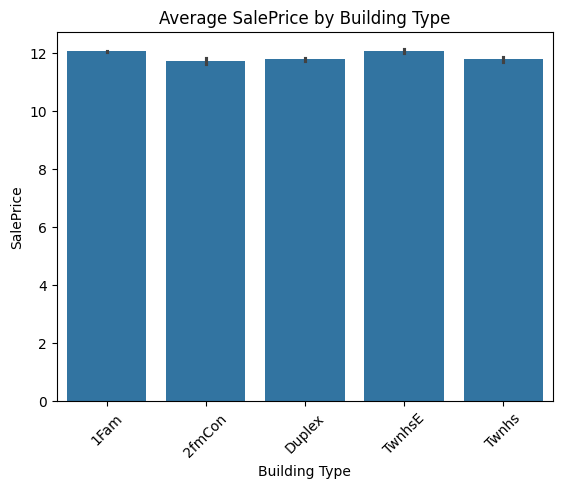

In [ ]:
#Plot of BldfType vs SalePrice
sns.barplot(x='BldgType', y='SalePrice', data=housing)
plt.title('Average SalePrice by Building Type')
plt.xlabel('Building Type')
plt.ylabel('SalePrice')
plt.xticks(rotation=45)
plt.show()

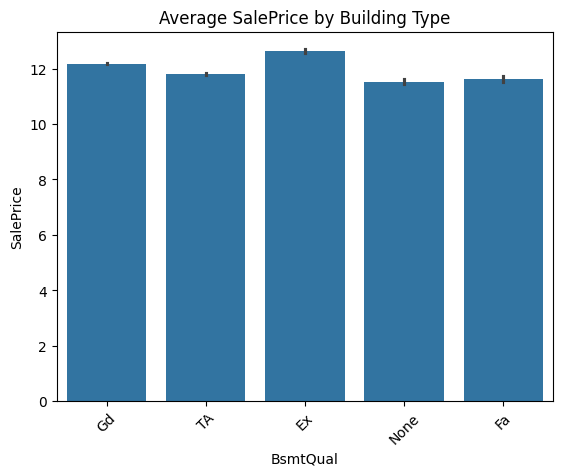

In [ ]:
#Plot of BsmtQual vs SalePrice
sns.barplot(x='BsmtQual', y='SalePrice', data=housing)
plt.title('Average SalePrice by Building Type')
plt.xlabel('BsmtQual')
plt.ylabel('SalePrice')
plt.xticks(rotation=45)
plt.show()

## Conclusion:
     -We can see that the RL(Residential Low Density) has the highest lot frontage and RM(Residential Medium Density) has the least
     -We can see thet 2-STORY 1946 & NEWER has the highest lot frontage and PUD-MULTILEVEL - INCL SPLIT LEV/FOYER has the least
     -The SalePrice is not showing much variance with respect to the Style of dwelling(one story /two story)
     -The SalePrice is almost same for all the Building Types(Types of dwelling)and the basement quality, so there is no significant pattern

In [ ]:
#Calculating the Age of the property
housing["Age"]=housing["YrSold"]-housing["YearBuilt"]
housing["Age"].head()

0     5
1    31
2     7
3    91
4     8
Name: Age, dtype: int64

In [ ]:
#Dropping Years Sold and Year Built
housing.drop(columns=["YearBuilt","YrSold"],axis=1,inplace=True)

In [ ]:
housing.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,Age
0,60,RL,65.0,8450,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,None,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,None,None,None,0,2,WD,Normal,12.247694,5
1,20,RL,80.0,9600,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,Gable,CompShg,MetalSd,MetalSd,BrkFace,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,None,None,None,0,5,WD,Normal,12.109011,31
2,60,RL,68.0,11250,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,None,None,None,0,9,WD,Normal,12.317167,7
3,70,RL,60.0,9550,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1970,Gable,CompShg,Wd Sdng,Wd Shng,BrkFace,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,None,None,None,0,2,WD,Abnorml,11.849398,91
4,60,RL,84.0,14260,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,None,None,None,0,12,WD,Normal,12.429216,8


## Correlation between Numerical Columns

Text(0.5, 1.0, 'Correlation of Numerical Values')

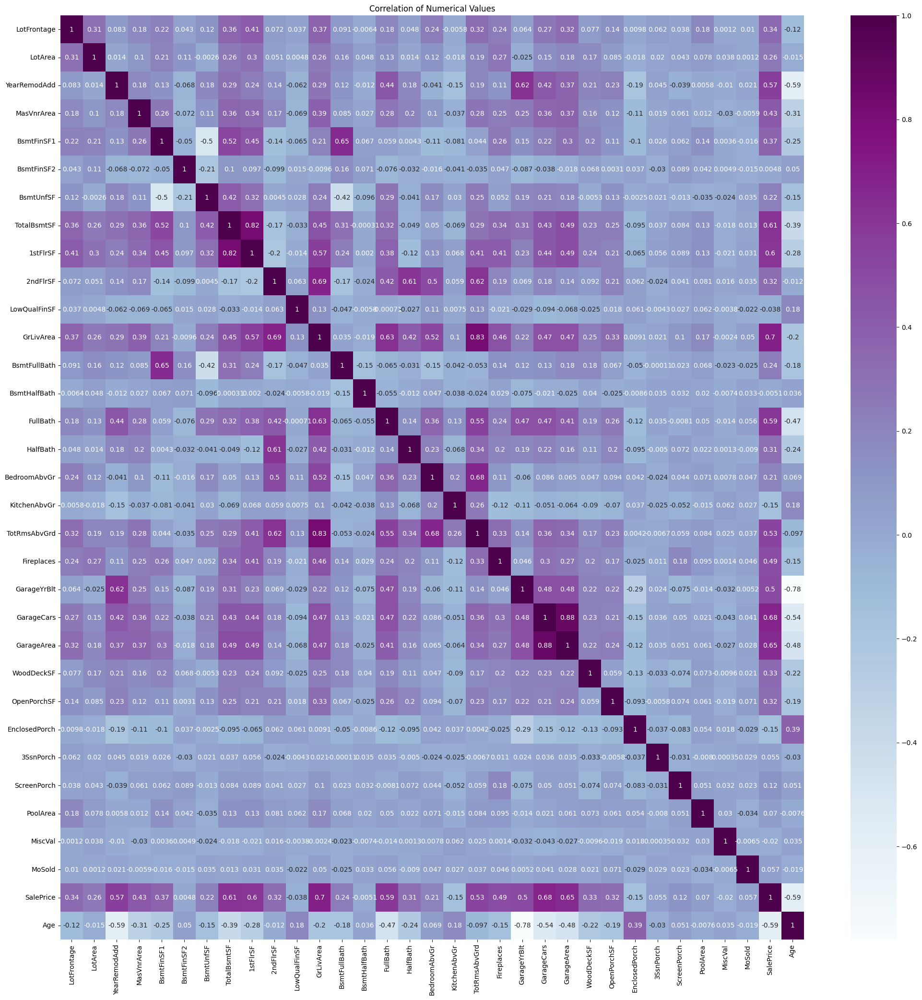

In [ ]:
plt.figure(figsize=[25,25])
sns.heatmap(housing.corr(numeric_only=True),annot=True,cmap="BuPu")
plt.title("Correlation of Numerical Values")

## Get top 10 correlated terms

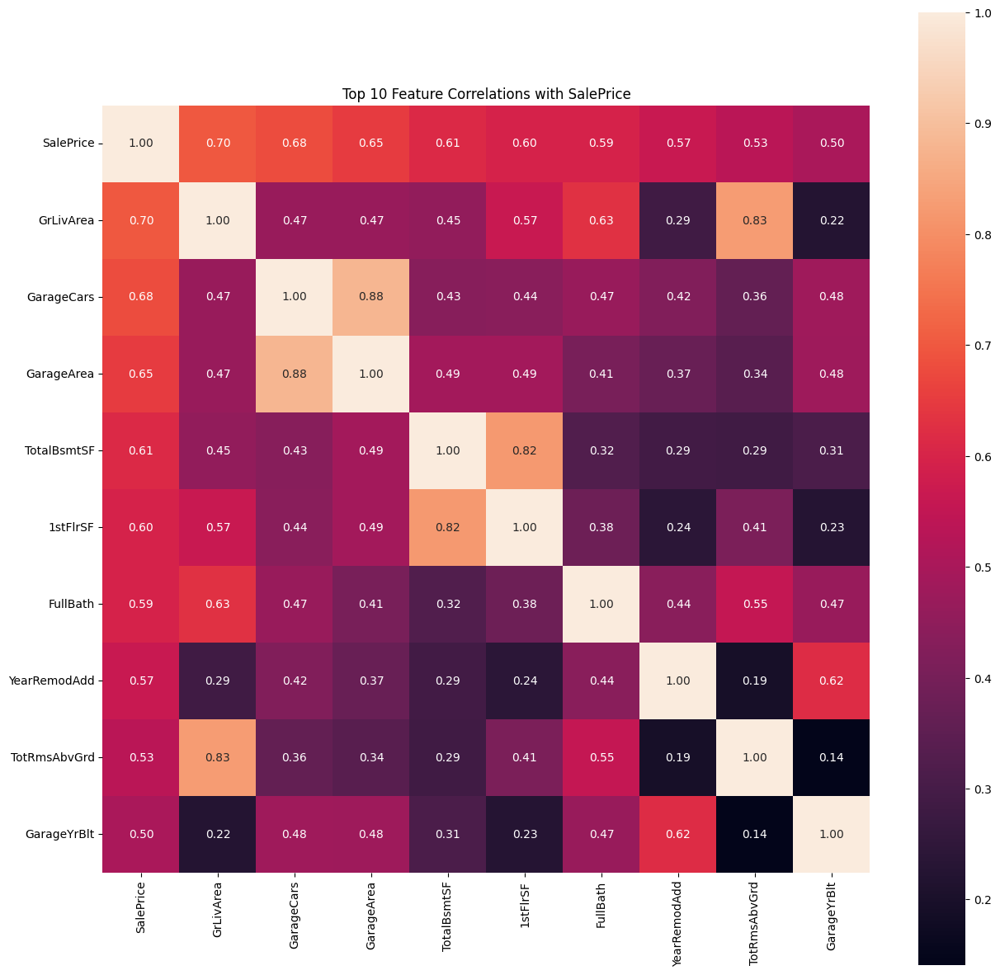

In [ ]:
k = 10
plt.figure(figsize=[15, 15])
cols = housing.corr(numeric_only=True).nlargest(k, "SalePrice").index
cm = np.corrcoef(housing[cols].values.T)
sns.heatmap(cm, annot=True, square=True, fmt='.2f', cbar=True,
            annot_kws={"size":10}, yticklabels=cols.values, xticklabels=cols.values)
plt.title("Top 10 Feature Correlations with SalePrice")
plt.show()

## We can observe that
GarageArea and GarageCars are highy correlated with coeff of 0.88
GrLivArea and TotRmsAbvGrd are highly correlated with coeff of 0.83
TotalBsmtSF and FirstLlrSF are highly correlated with coeff of 0.82


## Pair Plot for numerical Columns

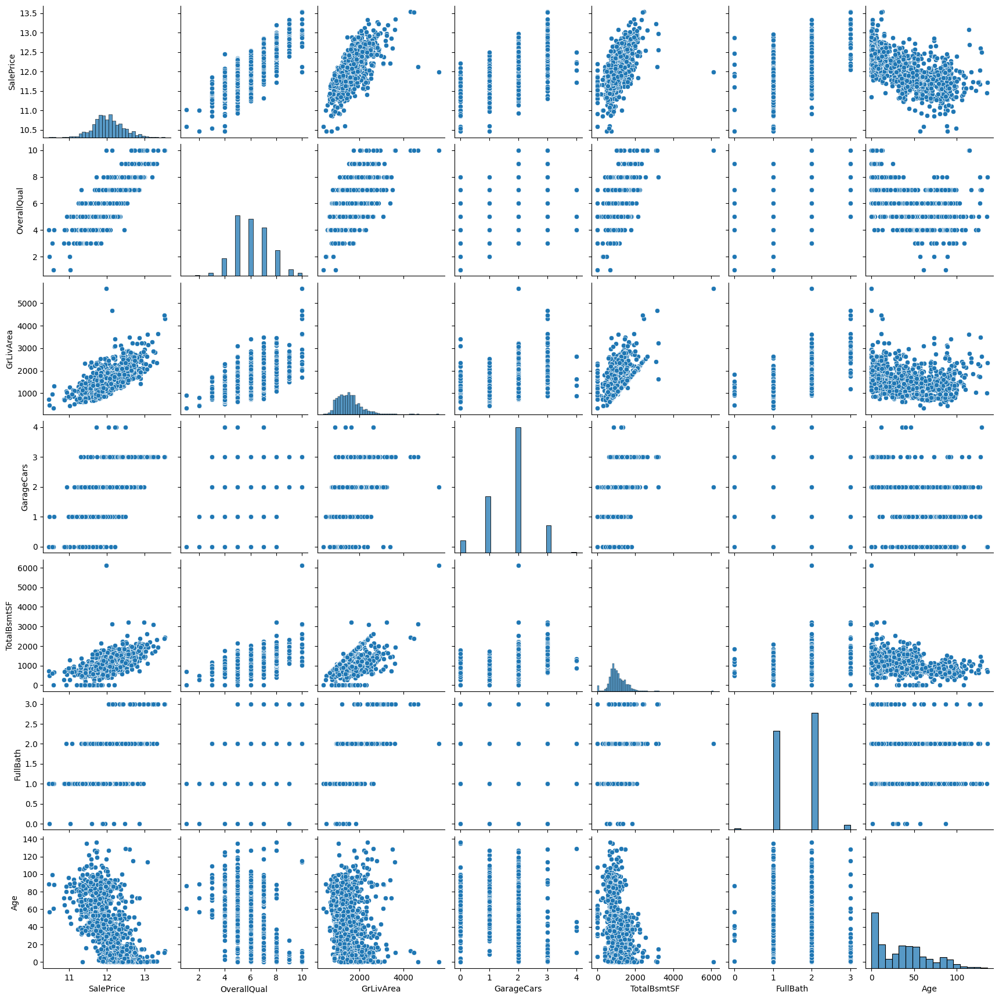

In [ ]:
cols = ["SalePrice", "OverallQual", "GrLivArea", "GarageCars", "TotalBsmtSF","FullBath","Age" ]
sns.pairplot(housing[cols])
plt.show()

## We can see that has negative correlation with target variable SalePrice and TotalBsmtSF and GrLivArea have positive correlation with SalePrice

## Step 4: Data Preparation

## Dummy Encoding

In [ ]:
housing_num=housing.select_dtypes(include=['int64','float64'])
housing_cat=housing.select_dtypes(include='object')

In [ ]:
housing_cat

,MSSubClass,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,60,RL,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,None,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal
1,20,RL,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,Gable,CompShg,MetalSd,MetalSd,BrkFace,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal
2,60,RL,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal
3,70,RL,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,Wd Sdng,Wd Shng,BrkFace,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,None,None,None,WD,Abnorml
4,60,RL,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal
5,50,RL,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,Wood,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,None,Attchd,Unf,TA,TA,Y,None,MnPrv,Shed,WD,Normal
6,20,RL,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,Gable,CompShg,VinylSd,VinylSd,Stone,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Gd,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal
7,60,RL,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,Gable,CompShg,HdBoard,HdBoard,Stone,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,Shed,WD,Normal
8,50,RM,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,Gable,CompShg,BrkFace,Wd Shng,BrkFace,TA,TA,BrkTil,TA,TA,No,Unf,Unf,GasA,Gd,Y,FuseF,TA,Min1,TA,Detchd,Unf,Fa,TA,Y,None,None,None,WD,Abnorml
9,190,RL,Pave,None,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,Gable,CompShg,MetalSd,MetalSd,BrkFace,TA,TA,BrkTil,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,Gd,TA,Y,None,None,None,WD,Normal


In [ ]:
housing_cat_dum = pd.get_dummies(housing_cat, drop_first=True).astype(int)
housing_cat_dum

,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_A

In [ ]:
house=pd.concat([housing_num,housing_cat_dum],axis=1)

In [ ]:
house.head()

,LotFrontage,LotArea,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SalePrice,Age,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa

In [ ]:
house.shape

(1460, 286)

In [ ]:
#Spit into Target and Feature Variables
X = house.drop(["SalePrice"], axis=1).copy()
Y = house["SalePrice"].copy()

In [ ]:
X.head()

,LotFrontage,LotArea,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,Age,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCon

In [ ]:
Y.head()

0    12.247694
1    12.109011
2    12.317167
3    11.849398
4    12.429216
Name: SalePrice, dtype: float64

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.3,random_state=42)

In [ ]:
X_train.shape

(1022, 285)

In [ ]:
Y_train.shape

(1022,)

## Scaling the dataset with Standard Scalar

In [ ]:
num_cols=list(X_train.select_dtypes(include=['int64','float64']).columns)

In [ ]:
scaler=StandardScaler()
X_train[num_cols]=scaler.fit_transform(X_train[num_cols])
X_test[num_cols]=scaler.fit_transform(X_test[num_cols])

In [ ]:
from sklearn.metrics import r2_score, mean_squared_error
def eval_metrics(Y_train, Y_train_pred, Y_test, Y_pred):
    print("R² score (train):", '%.2f' % r2_score(Y_train, Y_train_pred))
    print("R² score (test):", '%.2f' % r2_score(Y_test, Y_pred))
    mse_train = mean_squared_error(Y_train, Y_train_pred)
    mse_test = mean_squared_error(Y_test, Y_pred)
    rmse_train = mse_train ** 0.5
    rmse_test = mse_test ** 0.5
    print("RMSE (train):", '%.2f' % rmse_train)
    print("RMSE (test):", '%.2f' % rmse_test)

## Step 5:Build ML Model

In [ ]:
# Import ML Libs
import sklearn
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import GridSearchCV

# Applying Ridge Regression with tuning the hyperparameter 'alpha'
params = {
    'alpha': [
        0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5,
        0.6, 0.7, 0.8, 0.9, 1.0, 2, 3, 4, 5, 6, 7, 8, 9, 10,
        20, 50, 100, 200, 500, 1000
    ]
}

ridge = Ridge()
ridgeCV = GridSearchCV(
    estimator=ridge,
    param_grid=params,
    scoring='neg_mean_absolute_error',
    cv=5,
    return_train_score=True,
    verbose=1,
    n_jobs=-1
)

# Fit the model
ridgeCV.fit(X_train, Y_train)

# Best parameters and score
print("Best Parameters:", ridgeCV.best_params_)
print("Best MAE (negative):", ridgeCV.best_score_)


Fitting 5 folds for each of 29 candidates, totalling 145 fits
Best Parameters: {'alpha': 200}
Best MAE (negative): -0.09538232415747339


In [ ]:
ridgeCV.cv_results_

{'mean_fit_time': array([0.10218925, 0.10430822, 0.09020948, 0.04857039, 0.03160262,
        0.02644114, 0.04203043, 0.0219398 , 0.03130965, 0.04126844,
        0.02517238, 0.02871523, 0.02954021, 0.03993402, 0.02970543,
        0.03590207, 0.03152885, 0.03218646, 0.02954569, 0.03620825,
        0.0268681 , 0.06881676, 0.02950635, 0.03062482, 0.05526891,
        0.10672255, 0.06839199, 0.03011093, 0.02523561]),
 'std_fit_time': array([0.0129056 , 0.01299001, 0.00936349, 0.02696247, 0.01285522,
        0.0060042 , 0.01468453, 0.0044434 , 0.01097989, 0.01455953,
        0.00288844, 0.01017419, 0.00517188, 0.01275706, 0.00669831,
        0.01570293, 0.00218678, 0.00194948, 0.01865235, 0.01164635,
        0.01632585, 0.05557353, 0.01582471, 0.01744018, 0.04671564,
        0.06020869, 0.06158748, 0.01885795, 0.01241048]),
 'mean_score_time': array([0.0237175 , 0.0254899 , 0.02328849, 0.01714973, 0.01552429,
        0.01232944, 0.01444793, 0.01202688, 0.01083159, 0.01546731,
        0.011615

In [ ]:
ridge=Ridge(alpha=200)

In [ ]:
ridge.fit(X_train,Y_train)

,alpha,200
,fit_intercept,True
,copy_X,True
,max_iter,None
,tol,0.0001
,solver,'auto'
,positive,False
,random_state,None


In [ ]:
ridge.coef_

array([ 1.44225921e-03,  1.37641170e-02,  1.88542518e-02,  8.67671519e-03,
        9.33265520e-03,  5.37696625e-03,  3.58452072e-03,  1.49847286e-02,
        2.55566164e-02,  1.90858711e-02,  4.15699055e-03,  3.49814679e-02,
        1.36815935e-02, -1.76835187e-03,  2.07980784e-02,  1.65356035e-02,
        9.61631033e-03, -1.17352231e-02,  2.30331411e-02,  1.48392055e-02,
        4.73355990e-03,  2.48356099e-02,  1.81982043e-02,  1.24927703e-02,
        2.15172687e-03,  3.44448495e-03,  6.71418458e-03,  1.19694596e-02,
        1.31788665e-02,  3.82561051e-04,  4.00265896e-03, -1.99881648e-02,
       -1.82882346e-02,  2.35255003e-03, -2.13966949e-03,  1.75481018e-03,
        9.80043441e-04,  6.45088605e-03,  3.66352905e-03, -3.67246040e-03,
       -1.40924294e-03, -4.77001176e-03, -5.08442974e-03, -1.54702199e-02,
       -3.91379103e-03, -1.48097266e-03,  7.64554047e-03,  2.19878893e-03,
        9.79716168e-03, -4.32744460e-03,  1.19366849e-03, -2.47415635e-03,
        9.91012208e-03,  

In [ ]:
Y_train_pred= ridge.predict(X_train)
Y_pred=ridge.predict(X_test)

In [ ]:
eval_metrics(Y_train,Y_train_pred,Y_test,Y_pred)

R² score (train): 0.93
R² score (test): 0.89
RMSE (train): 0.10
RMSE (test): 0.14


In [ ]:
ridgeCV_res=pd.DataFrame(ridgeCV.cv_results_)
ridgeCV_res.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.102189,0.012906,0.023717,0.003658,0.0001,{'alpha': 0.0001},-0.088140,-0.118304,-0.106160,-0.092540,-0.105811,-0.102191,0.010762,29,-0.059908,-0.052745,-0.052810,-0.057496,-0.059162,-0.056424,0.003078
1,0.104308,0.012990,0.025490,0.003119,0.0010,{'alpha': 0.001},-0.088143,-0.118364,-0.106126,-0.092529,-0.105783,-0.102189,0.010776,28,-0.059910,-0.052746,-0.052814,-0.057499,-0.059163,-0.056427,0.003078
2,0.090209,0.009363,0.023288,0.004157,0.0100,{'alpha': 0.01},-0.088175,-0.118905,-0.105806,-0.092439,-0.105504,-0.102166,0.010908,27,-0.059929,-0.052760,-0.052854,-0.057531,-0.059182,-0.056451,0.003075
3,0.048570,0.026962,0.017150,0.004742,0.0500,{'alpha': 0.05},-0.088300,-0.120426,-0.104700,-0.092187,-0.104427,-0.102008,0.011284,26,-0.060008,-0.052804,-0.052998,-0.057656,-0.059261,-0.056545,0.003072
4,0.031603,0.012855,0.015524,0.003265,0.1000,{'alpha': 0.1},-0.088423,-0.121369,-0.103716,-0.091985,-0.103424,-0.101783,0.011529,24,-0.060099,-0.052839,-0.053133,-0.057800,-0.059364,-0.056647,0.003082


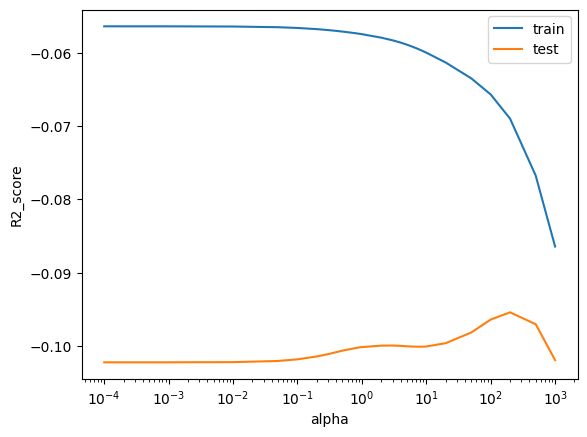

In [ ]:
plt.plot(ridgeCV_res['param_alpha'],ridgeCV_res['mean_train_score'],label="train")
plt.plot(ridgeCV_res['param_alpha'],ridgeCV_res['mean_test_score'],label="test")
plt.xlabel('alpha')
plt.ylabel('R2_score')
plt.xscale('log')
plt.legend()
plt.show()

In [ ]:
params = {
    'alpha': [
        0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5,
        0.6, 0.7, 0.8, 0.9, 1.0, 2, 3, 4, 5, 6, 7, 8, 9, 10,
        20, 50, 100, 200, 500, 1000
    ]
}

# Initialize Lasso model
lasso = Lasso()  # Increase max_iter to ensure convergence

# Set up GridSearchCV
lassoCV = GridSearchCV(
    estimator=lasso,
    param_grid=params,
    scoring='neg_mean_absolute_error',
    cv=5,
    return_train_score=True,
    verbose=1,
    n_jobs=-1
)

# Fit the model
lassoCV.fit(X_train, Y_train)

# Print best parameters and score
print("Best Parameters:", lassoCV.best_params_)
print("Best MAE (negative):", lassoCV.best_score_)

Fitting 5 folds for each of 29 candidates, totalling 145 fits
Best Parameters: {'alpha': 0.001}
Best MAE (negative): -0.09385763529653372


In [ ]:
lasso=Lasso(alpha=0.001)

In [ ]:
lasso.fit(X_train,Y_train)

,alpha,0.001
,fit_intercept,True
,precompute,False
,copy_X,True
,max_iter,1000
,tol,0.0001
,warm_start,False
,positive,False
,random_state,None
,selection,'cyclic'


In [ ]:
lasso.coef_

array([ 2.90989279e-03,  1.43419376e-02,  2.02535428e-02,  5.61104055e-03,
        9.44025631e-03,  3.64058553e-03, -0.00000000e+00,  2.84929347e-02,
        0.00000000e+00,  0.00000000e+00,  1.11523875e-03,  1.01223889e-01,
        1.61326780e-02, -0.00000000e+00,  1.47554181e-02,  1.26412022e-02,
        1.98632980e-03, -1.91187088e-02,  1.69042777e-02,  1.48399170e-02,
       -0.00000000e+00,  2.15011156e-02,  2.12052903e-02,  1.08648890e-02,
        0.00000000e+00,  5.87528428e-03,  6.18223127e-03,  1.26788923e-02,
        2.24440629e-01, -0.00000000e+00,  1.01580304e-03, -5.34847888e-02,
       -1.63111849e-02,  2.87396754e-04, -0.00000000e+00,  0.00000000e+00,
       -5.37048260e-03,  3.32994374e-03,  1.19266441e-03, -2.66044649e-03,
       -0.00000000e+00, -4.99055139e-03, -0.00000000e+00, -1.81655493e-02,
       -1.46687974e-03, -0.00000000e+00,  8.79293027e-03,  1.12200444e-03,
        8.68646208e-03, -0.00000000e+00,  1.12742193e-03, -2.30877393e-03,
        1.20731648e-02,  

In [ ]:
Y_train_pred1= lasso.predict(X_train)
Y_pred1=lasso.predict(X_test)

In [ ]:
eval_metrics(Y_train,Y_train_pred1,Y_test,Y_pred1)

R² score (train): 0.94
R² score (test): 0.87
RMSE (train): 0.09
RMSE (test): 0.15


In [ ]:
lassoCV_res=pd.DataFrame(lassoCV.cv_results_)
ridgeCV_res.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.102189,0.012906,0.023717,0.003658,0.0001,{'alpha': 0.0001},-0.088140,-0.118304,-0.106160,-0.092540,-0.105811,-0.102191,0.010762,29,-0.059908,-0.052745,-0.052810,-0.057496,-0.059162,-0.056424,0.003078
1,0.104308,0.012990,0.025490,0.003119,0.0010,{'alpha': 0.001},-0.088143,-0.118364,-0.106126,-0.092529,-0.105783,-0.102189,0.010776,28,-0.059910,-0.052746,-0.052814,-0.057499,-0.059163,-0.056427,0.003078
2,0.090209,0.009363,0.023288,0.004157,0.0100,{'alpha': 0.01},-0.088175,-0.118905,-0.105806,-0.092439,-0.105504,-0.102166,0.010908,27,-0.059929,-0.052760,-0.052854,-0.057531,-0.059182,-0.056451,0.003075
3,0.048570,0.026962,0.017150,0.004742,0.0500,{'alpha': 0.05},-0.088300,-0.120426,-0.104700,-0.092187,-0.104427,-0.102008,0.011284,26,-0.060008,-0.052804,-0.052998,-0.057656,-0.059261,-0.056545,0.003072
4,0.031603,0.012855,0.015524,0.003265,0.1000,{'alpha': 0.1},-0.088423,-0.121369,-0.103716,-0.091985,-0.103424,-0.101783,0.011529,24,-0.060099,-0.052839,-0.053133,-0.057800,-0.059364,-0.056647,0.003082


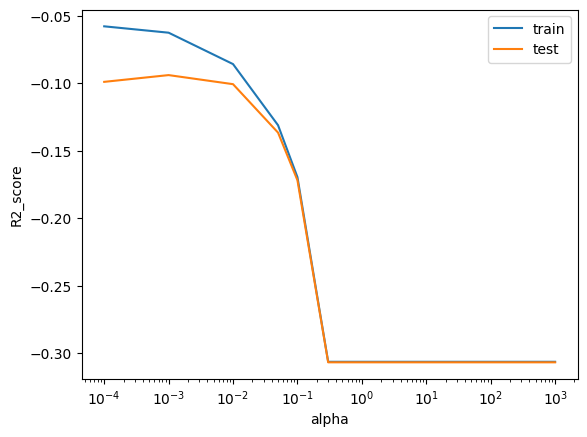

In [ ]:
plt.plot(lassoCV_res['param_alpha'],lassoCV_res['mean_train_score'],label="train")
plt.plot(lassoCV_res['param_alpha'],lassoCV_res['mean_test_score'],label="test")
plt.xlabel('alpha')
plt.ylabel('R2_score')
plt.xscale('log')
plt.legend()
plt.show()

## Feature Extraction/Elimination

In [ ]:
betas=pd.DataFrame(index=X.columns)
betas.rows=X.columns
betas['Ridge']=ridge.coef_
betas['Lasso']=lasso.coef_
betas

,Ridge,Lasso
LotFrontage,0.001442,2.909893e-03
LotArea,0.013764,1.434194e-02
YearRemodAdd,0.018854,2.025354e-02
MasVnrArea,0.008677,5.611041e-03
BsmtFinSF1,0.009333,9.440256e-03
BsmtFinSF2,0.005377,3.640586e-03
BsmtUnfSF,0.003585,-0.000000e+00
TotalBsmtSF,0.014985,2.849293e-02
1stFlrSF,0.025557,0.000000e+00
2ndFlrSF,0.019086,0.000000e+00


In [ ]:
lasso_cols_removed=list(betas[betas['Lasso']==0].index)
print(lasso_cols_removed)

['BsmtUnfSF', '1stFlrSF', '2ndFlrSF', 'BsmtHalfBath', 'GarageYrBlt', 'OpenPorchSF', 'MiscVal', 'MSSubClass_45', 'MSSubClass_50', 'MSSubClass_85', 'MSSubClass_120', 'MSSubClass_190', 'MSZoning_RM', 'LotShape_IR3', 'LotShape_Reg', 'LandContour_Low', 'LandSlope_Sev', 'Neighborhood_BrDale', 'Neighborhood_CollgCr', 'Neighborhood_Gilbert', 'Neighborhood_Mitchel', 'Neighborhood_SawyerW', 'Condition2_Norm', 'Condition2_PosA', 'Condition2_RRAn', 'Condition2_RRNn', 'BldgType_2fmCon', 'HouseStyle_2.5Fin', 'HouseStyle_SLvl', 'OverallQual_6', 'OverallCond_6', 'RoofStyle_Hip', 'RoofMatl_CompShg', 'RoofMatl_Membran', 'RoofMatl_WdShake', 'Exterior1st_AsphShn', 'Exterior1st_CemntBd', 'Exterior1st_ImStucc', 'Exterior1st_Plywood', 'Exterior1st_VinylSd', 'Exterior2nd_Brk Cmn', 'Exterior2nd_CBlock', 'Exterior2nd_HdBoard', 'Exterior2nd_MetalSd', 'Exterior2nd_Stucco', 'Exterior2nd_VinylSd', 'Exterior2nd_Wd Shng', 'MasVnrType_BrkFace', 'ExterQual_Gd', 'ExterCond_Gd', 'Foundation_CBlock', 'Foundation_Stone', '

In [ ]:
lasso_cols_selected=list(betas[betas['Lasso']!=0].index)
print(lasso_cols_selected)

['LotFrontage', 'LotArea', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'TotalBsmtSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MoSold', 'Age', 'MSSubClass_30', 'MSSubClass_40', 'MSSubClass_60', 'MSSubClass_70', 'MSSubClass_75', 'MSSubClass_80', 'MSSubClass_90', 'MSSubClass_160', 'MSSubClass_180', 'MSZoning_FV', 'MSZoning_RH', 'MSZoning_RL', 'Street_Pave', 'Alley_None', 'Alley_Pave', 'LotShape_IR2', 'LandContour_HLS', 'LandContour_Lvl', 'Utilities_NoSeWa', 'LotConfig_CulDSac', 'LotConfig_FR2', 'LotConfig_FR3', 'LotConfig_Inside', 'LandSlope_Mod', 'Neighborhood_Blueste', 'Neighborhood_BrkSide', 'Neighborhood_ClearCr', 'Neighborhood_Crawfor', 'Neighborhood_Edwards', 'Neighborhood_IDOTRR', 'Neighborhood_MeadowV', 'Neighborhood_NAmes', 'Neighborhood_NPkVill', 'Neighborhood_NWAmes', 'Neighbo

In [ ]:
print(len(lasso_cols_removed))
print(len(lasso_cols_selected))

79
206


## Top 10 features significant in predicting the value of a house both according to Ridge model and Lasso model

In [ ]:
betas['Ridge'].sort_values(ascending=False)[:10]

GrLivArea               0.034981
OverallQual_9           0.027311
1stFlrSF                0.025557
GarageCars              0.024836
OverallQual_8           0.023048
TotRmsAbvGrd            0.023033
Neighborhood_NridgHt    0.020901
FullBath                0.020798
2ndFlrSF                0.019086
YearRemodAdd            0.018854
Name: Ridge, dtype: float64

In [ ]:
ridge_coeffs=np.exp(betas['Ridge'])
ridge_coeffs.sort_values(ascending=False)[:10]

GrLivArea               1.035601
OverallQual_9           1.027688
1stFlrSF                1.025886
GarageCars              1.025147
OverallQual_8           1.023316
TotRmsAbvGrd            1.023300
Neighborhood_NridgHt    1.021121
FullBath                1.021016
2ndFlrSF                1.019269
YearRemodAdd            1.019033
Name: Ridge, dtype: float64

In [ ]:
betas['Lasso'].sort_values(ascending=False)[:10]

PoolArea                0.224441
PoolQC_None             0.205693
GrLivArea               0.101224
OverallQual_9           0.031609
OverallQual_8           0.031037
TotalBsmtSF             0.028493
Neighborhood_Crawfor    0.021869
GarageCars              0.021501
GarageArea              0.021205
Neighborhood_NridgHt    0.020981
Name: Lasso, dtype: float64

In [ ]:
lasso_coeffs=np.exp(betas['Lasso'])
lasso_coeffs.sort_values(ascending=False)[:10]

PoolArea                1.251622
PoolQC_None             1.228377
GrLivArea               1.106524
OverallQual_9           1.032114
OverallQual_8           1.031524
TotalBsmtSF             1.028903
Neighborhood_Crawfor    1.022110
GarageCars              1.021734
GarageArea              1.021432
Neighborhood_NridgHt    1.021202
Name: Lasso, dtype: float64

In [ ]:
##Conclusion
Below are the Top 10 features with corresponding coefficients according to the model
OverallQual              1.096417
GrLivArea                1.047379
Neighborhood_Crawfor     1.006561
Neighborhood_Blueste     1.004757
LandContour_HLS          1.002633
CentralAir_Y             1.002471
OverallCond_9            1.002071
BsmtCond_TA              1.001865
Below are the top 10 features with corresponding coefficients according to Lasso model
OverallQual              1.336647
GrLivArea                1.103152
Neighborhood_Crawfor     1.101128
OverallQual              1.091374
Neighborhood_StoneBr     1.080434
Neighborhood_NoRidge     1.076391
ExteriorBrkFace          1.073380
CentralAir_Y             1.071680
Functional_Typ           1.074188
BsmtCond_TA              1.074110

Few Inferences are:
Therefore, the price of the house will increase by 1.11 with the increase in GrLivArea.
The price of the house can increase by 1.10 times if the finish of the house is very good.
If the house has centralized air, the price can increase by 1.04 times.
If the basement condition is typical, then the house price may increase up to 1.08 times.
The price of the house may increase if the neighborhood has Crawford, Stone Brook and NoRidge (heights or physical locations).
Optimal value of Lambda for Ridge Regression = 200
Optimal value of Lambda for Lasso = 0.001